In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os

In [2]:
'Loda data'
cellplot = np.load('/home/qukun/wangrirui/project/GBM/bassfish_celltype/revise_202404/black_cellplot.npy')
segmentation = np.load('/home/qukun/wangrirui/project/GBM/bassfish_celltype/revise_202404/refine_seg.npy')
bountry_mask = np.load('/home/qukun/wangrirui/project/GBM/bassfish_celltype/revise_202404/bountry_line_mask.npy')

In [3]:
'Set colors'
clust_colors = {'TAM1':'#17728C',
                'TAM2':'#C1EDF6',
                'TAM3':'#C5E5BD',
                'TAM4':'#89CFC5',
                'TAM5':'#AA5FAC',
                'Monocytes':'#748EBF',
                'DC cells':'#00C8FB',
                'Oligodendrocyte':'#AE958C',
                #'B cells':'#ECD157', 
                #'Plasma cells':'#DABB57',
                'Treg cells':'#fc912a',
                #'T-IFI6':'#FF6666',
                'Cytotoxic CD8T':'#FD9DC6',
                'Exhausted CD8T':'#eedce4',
                'CD4T':'#FFB3A1',
                'T-HSPA1A':'#FFD9CE',
                #'NK cells':'#FF3D73',
                'MES1':'#4169E1',
                'MES2':'#D7008C',
                'AC-like':'#FED100',
                'OPC-like':'#00A555',
                'NPC-like':'#16CB55',
                #'neurons':'#4C8266',
                'Pericyte':'#C83726',
                'VSMCs':'#922226',
                'Endo':'#F51F1A'}

In [4]:
from PIL import ImageColor
def hex_to_rgb(hex_color):
    return np.array(ImageColor.getcolor(hex_color, "RGB"))

label = clust_colors.keys()
color_RGB = list(map(hex_to_rgb, clust_colors.values()))
clust_colors_rgb = dict(zip(label, color_RGB))

## Customize Color

In [5]:
def customize_color(image, celltype_list, new_hex_color_list):
    im = np.copy(image)
    r = image[...,0]
    g = image[...,1]
    b = image[...,2]
    for i, celltype in enumerate(celltype_list):
        origin_color = clust_colors_rgb[celltype]
        new_color = hex_to_rgb(new_hex_color_list[i])
        im[(r==origin_color[0])&(g==origin_color[1])&(b==origin_color[2])] = new_color
    return im

In [7]:
image = customize_color(cellplot, ['MES1','MES2'], ['#2A2AFA', '#FA009B'])

## Draw Figure J

In [10]:
import matplotlib.patches as mpathes
def draw_figure_J(refine_color_cellplot, save_path=None, dpi=900):
    bountry_image = np.copy(refine_color_cellplot)
    bountry_image[bountry_mask>0] = [255,255,255]
    
    top_xy = [800*15+400,800*6]
    mid_xy = [800*4+400,2500+800*4] #
    bot_xy = [800*0,9800+800*5]
    
    fig, ax = plt.subplots(1, 1, dpi=dpi)
    ax.imshow(bountry_image)
    ax.grid(False)
    ax.hlines(y=14000,xmin=11500,xmax=11500+400/0.16,colors='white')
    # top grid
    rect1 = mpathes.Rectangle(top_xy,800,800,fc='none',ec='white',lw=0.8)
    ax.add_patch(rect1)
    # mid grid
    rect2 = mpathes.Rectangle(mid_xy,800,800,fc='none',ec='white',lw=0.8)
    ax.add_patch(rect2)
    # bottom grid
    rect3 = mpathes.Rectangle(bot_xy,800,800,fc='none',ec='white',lw=0.8)
    ax.add_patch(rect3)

    ax.set_xticks([])
    ax.set_yticks([])
    if save_path != None:
        plt.savefig(save_path,dpi=dpi)
    plt.show()

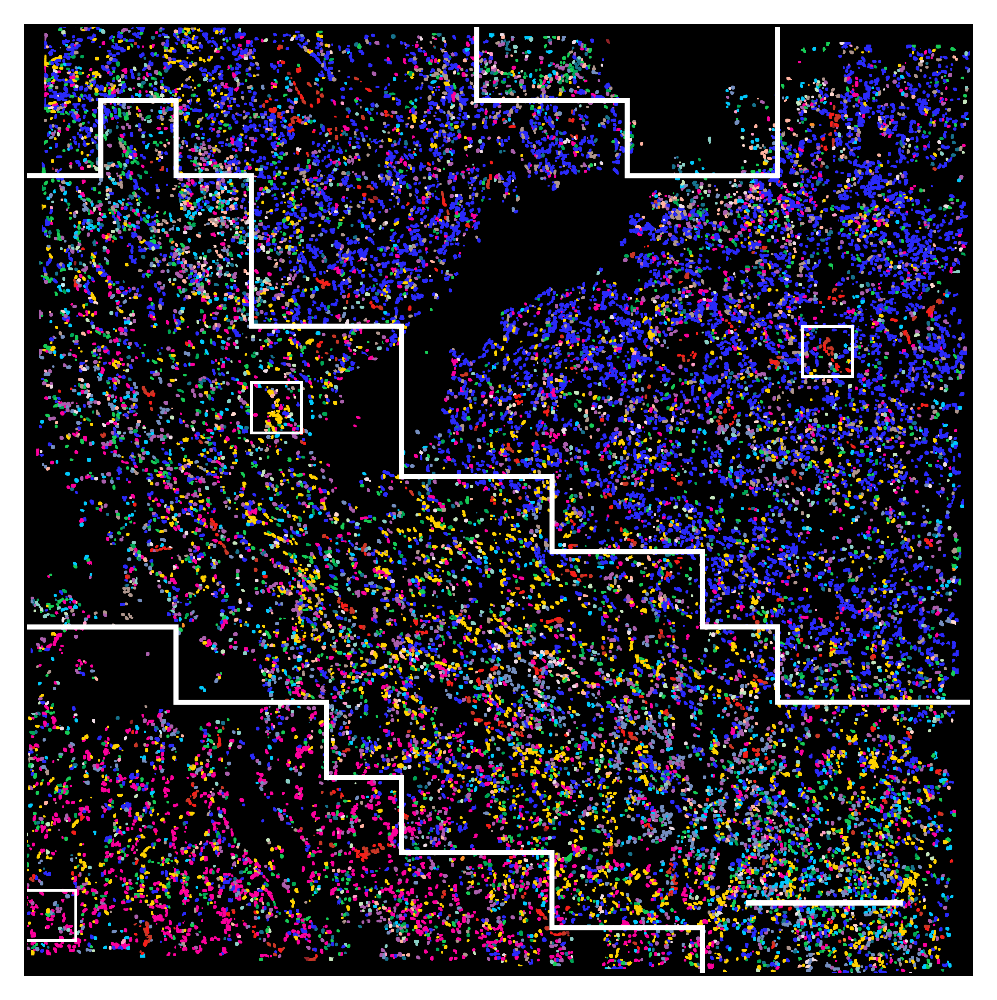

In [11]:
draw_figure_J(image, save_path='/home/qukun/ccp1997/GBM_10X/ng_revised/figure/result_3/Figure_J.v2.pdf')

## Draw Figure k

In [12]:
white_cellplot = np.copy(cellplot)
temp = cellplot[:,:,0] + cellplot[:,:,1] + cellplot[:,:,2]
white_cellplot[temp==0] = [255,255,255]

In [13]:
# MES1
temp_color_map = clust_colors_rgb.copy()
temp_color_map.pop("MES1")

MES1_plot = customize_color(white_cellplot, 
                            list(temp_color_map.keys()), 
                            ['#A0A0A0'] * len(temp_color_map))

MES1_plot = customize_color(MES1_plot, 
                            ['MES1'], 
                            ['#2A2AFA'])
MES1_plot[bountry_mask>0] = [0,0,0]

[]

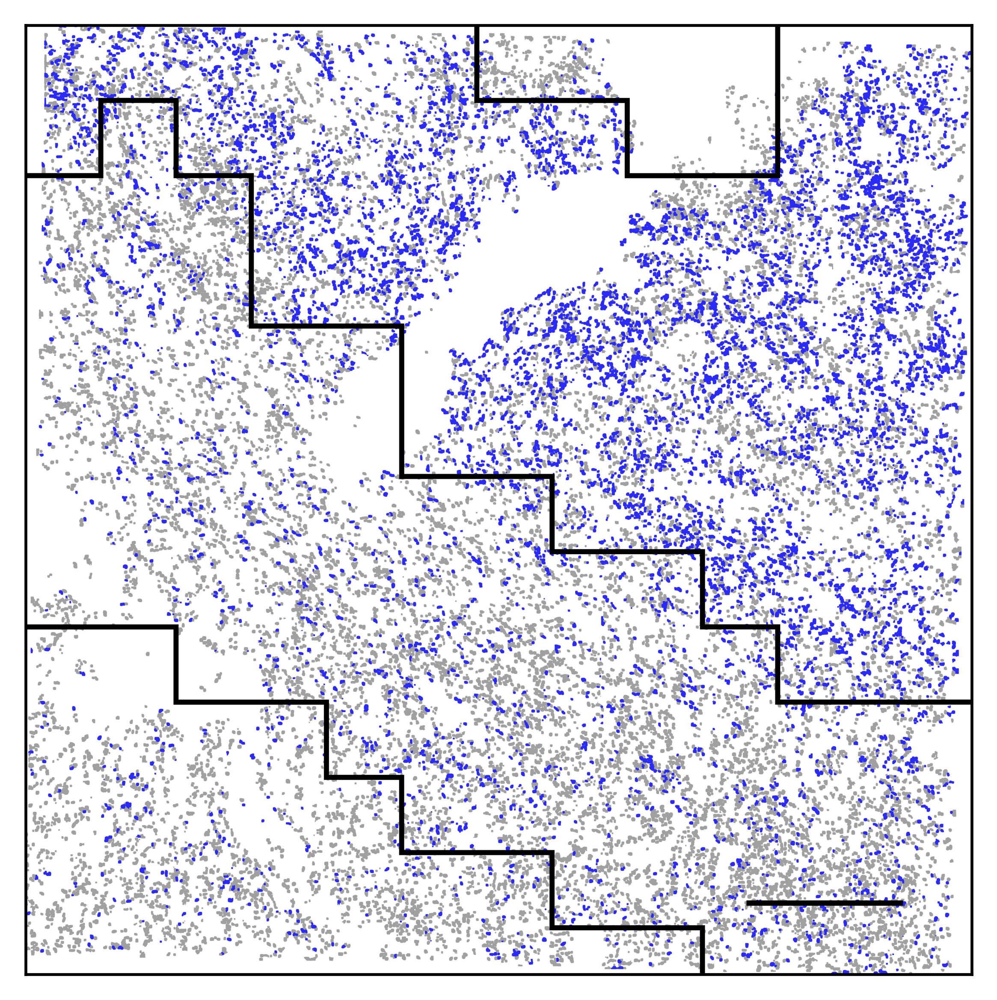

In [14]:
fig, ax = plt.subplots(1,1,dpi=600)
ax.imshow(MES1_plot)
ax.hlines(y=14000,xmin=11500,xmax=11500+400/0.16,colors='black')
ax.set_xticks([])
ax.set_yticks([])
#plt.savefig('./Figure/K_MES1_zone_v1.pdf',dpi=600)

In [15]:
# MES2
temp_color_map = clust_colors_rgb.copy()
temp_color_map.pop("MES2")
MES2_plot = customize_color(white_cellplot, 
                               list(temp_color_map.keys()), 
                               ['#A0A0A0'] * len(temp_color_map))
MES2_plot = customize_color(MES2_plot, 
                               ['MES2'], 
                               ['#FA009B'])
MES2_plot[bountry_mask>0] = [0,0,0] 

[]

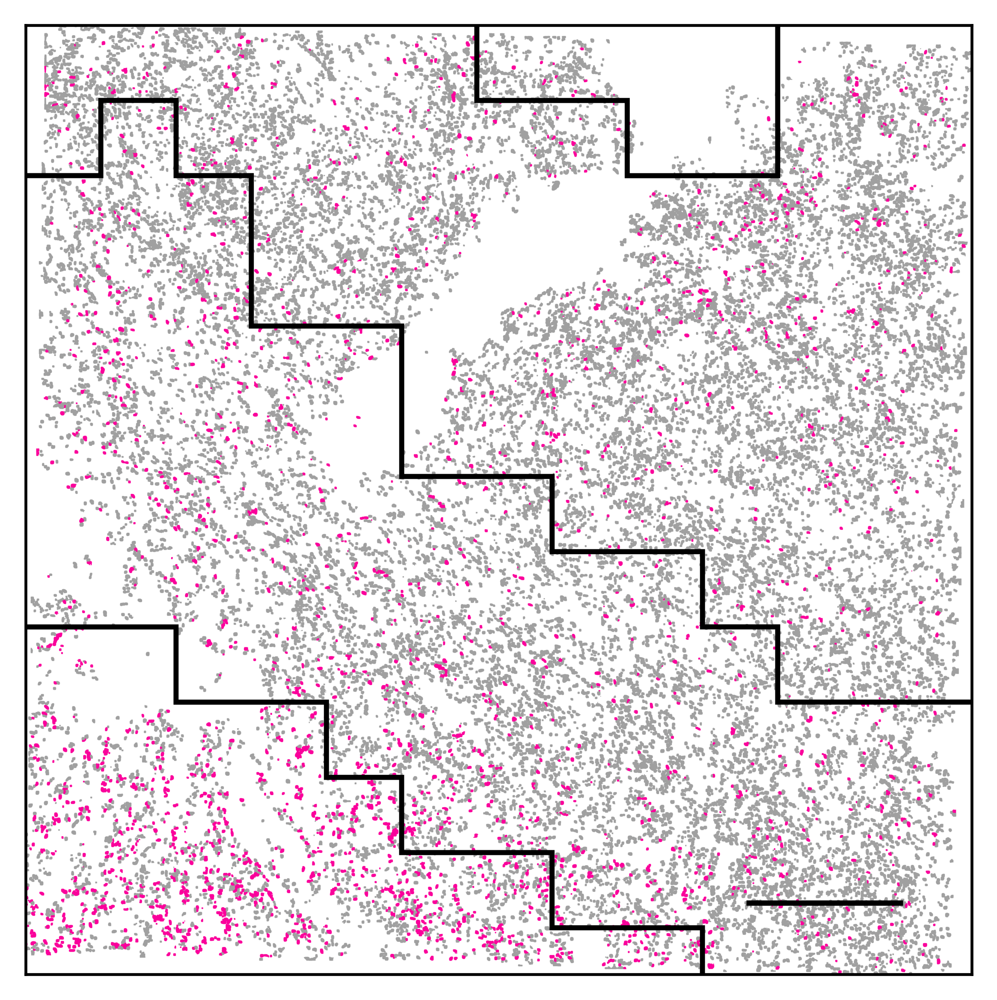

In [16]:
fig, ax = plt.subplots(1,1,dpi=600)
ax.imshow(MES2_plot)
ax.hlines(y=14000,xmin=11500,xmax=11500+400/0.16,colors='black')
ax.set_xticks([])
ax.set_yticks([])
#plt.savefig('./Figure/K_MES2_zone_v1.pdf',dpi=600)

In [17]:
# AC
temp_color_map = clust_colors_rgb.copy()
temp_color_map.pop("AC-like")
AC_plot = customize_color(white_cellplot, 
                        list(temp_color_map.keys()), 
                        ['#A0A0A0'] * len(temp_color_map))
AC_plot = customize_color(AC_plot, 
                          ['AC-like'], 
                          ['#FEAF00'])
AC_plot[bountry_mask>0] = [0,0,0]

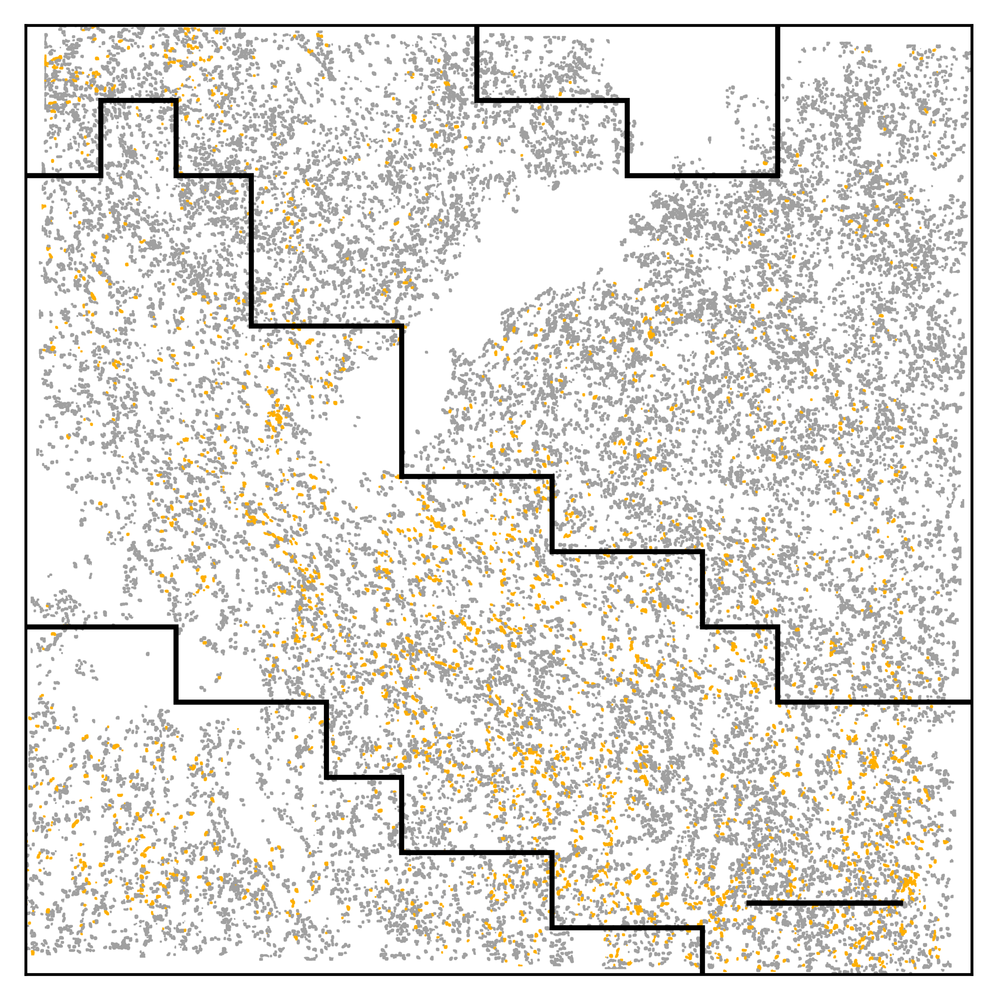

In [18]:
fig, ax = plt.subplots(1,1,dpi=600)
ax.imshow(AC_plot)
ax.hlines(y=14000,xmin=11500,xmax=11500+400/0.16,colors='black')
ax.set_xticks([])
ax.set_yticks([])
plt.savefig('/home/qukun/ccp1997/GBM_10X/ng_revised/figure/result_3/K_AC_zone_v1.pdf',dpi=600)

## Draw Figure i

In [19]:
import cv2
from skimage.segmentation import find_boundaries
def add_bountry(tar_im, im, seg_im, curr_x, curr_y,  bountry_color, window_size=800,iterations=2):
    
    crop_im = np.copy(im[curr_x:curr_x+window_size,curr_y:curr_y+window_size,:])
    crop_seg = np.copy(seg_im[curr_x:curr_x+window_size,curr_y:curr_y+window_size,:])
    
    # get bountry
    # from skimage.segmentation import find_boundaries
    def make_outline_overlay(rgb_data, predictions):
        if len(predictions.shape) != 4:
            raise ValueError('Predictions must be 4D, got {}'.format(predictions.shape))

        if predictions.shape[0] > rgb_data.shape[0]:
            raise ValueError('Must supply an rgb image for each prediction')

        boundaries = np.zeros_like(rgb_data)
        overlay_data = np.copy(rgb_data)

        for img in range(predictions.shape[0]):
            boundary = find_boundaries(predictions[img, ..., 0], connectivity=1, mode='inner')
            boundaries[img, boundary > 0, :] = 1

        overlay_data[boundaries > 0] = 1

        return overlay_data
    
    crop_seg = np.squeeze(crop_seg)
    crop_seg = np.expand_dims(crop_seg, 0)
    crop_seg = np.expand_dims(crop_seg, -1)
    white = np.full(crop_seg.shape, 255)
    mask = make_outline_overlay(white, crop_seg)
    
    #import cv2
    if iterations > 0:
        kernel = np.ones((2, 2))
        img_dilate = cv2.erode(np.squeeze(mask).astype('uint8'), kernel, iterations=iterations)
    elif iterations < 0:
        kernel = np.ones((2, 2))
        img_dilate = cv2.dilate(np.squeeze(mask).astype('uint8'), kernel, iterations=-iterations)
    else:
        mask = np.squeeze(mask)
        img_dilate = mask
    tar_copy = np.copy(tar_im)  
    tar_copy[np.where(img_dilate==1)] = bountry_color

    return tar_copy

In [20]:
white_cellplot = np.copy(cellplot)
temp = cellplot[:,:,0] + cellplot[:,:,1] + cellplot[:,:,2]
white_cellplot[temp==0] = [255,255,255]

segmentation = np.squeeze(segmentation)
segmentation = np.expand_dims(segmentation, -1)

In [21]:
def draw_raw_sub_figure_I(position):
    if position == 'top':
        im = np.copy(white_cellplot[800*6:800*7,800*15+400:800*16+400])
        celltype = ['MES1', 'MES2', 'Endo', 'Pericyte','VSMCs', 'AC-like', 'OPC-like','NPC-like']
    elif position == 'mid':
        im = np.copy(white_cellplot[2500+800*4:2500+800*5,800*4+400:800*5+400])
        celltype = ['MES1', 'MES2', 'Endo', 'Pericyte','VSMCs', 'AC-like', 'OPC-like','NPC-like']
    else:
        im = np.copy(white_cellplot[9800+800*5:9800+800*6,800*0:800*1])
        celltype = ['MES1', 'MES2', 'Endo', 'Pericyte','VSMCs', 
                    'AC-like', 'OPC-like','NPC-like',
                    'Monocytes','TAM5']
    r, g, b = im[...,0], im[...,1], im[...,2]
    result = np.copy(im)
    result[(r!=255)|(g!=255)|(b!=255)] = [164, 226, 198]
    for item in celltype:
        color = clust_colors_rgb[item]
        result[(r==color[0])&(g==color[1])&(b==color[2])] = color
    return result

In [22]:
raw_top = draw_raw_sub_figure_I('top')
raw_mid = draw_raw_sub_figure_I('mid')
raw_bot = draw_raw_sub_figure_I('bot')

In [23]:

refine_top = customize_color(raw_top, 
                             ['MES2', 'MES1', 'Endo', 'Pericyte'], 
                             ['#D7008C', '#4169E1', '#F01F1A', '#B43826'])
refine_mid = customize_color(raw_mid, 
                             ['MES2', 'MES1', 'Endo', 'Pericyte'],  
                             ['#D7008C', '#4169E1', '#F01F1A', '#B43826'])
refine_bot = customize_color(raw_bot, 
                             ['MES2', 'MES1', 'Endo', 'Pericyte'], 
                             ['#D7008C', '#4169E1', '#F01F1A', '#B43826'])

In [24]:

bountry_top = add_bountry(refine_top, white_cellplot, segmentation, 
                             800*6, 800*15+400, 
                             bountry_color=[40,40,40],
                             iterations=2)
bountry_mid = add_bountry(refine_mid, white_cellplot, segmentation, 
                             #4100+800*10, 800*10, 
                             2500+800*4, 800*4+400,
                             bountry_color=[40,40,40],
                             iterations=2)

bountry_bot = add_bountry(refine_bot, white_cellplot, segmentation, 
                             9800+800*5, 800*0, 
                             bountry_color=[40,40,40],
                             iterations=2)

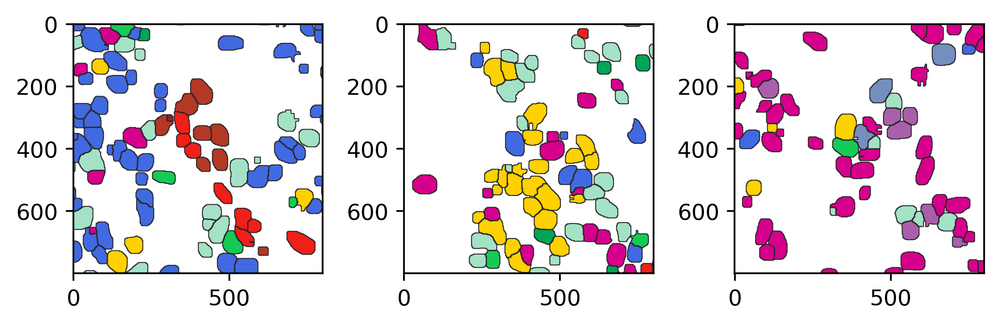

In [25]:
fig, ax = plt.subplots(1,3,dpi=400)
ax[0].imshow(bountry_top)
ax[1].imshow(bountry_mid)
ax[2].imshow(bountry_bot)
plt.tight_layout()

In [26]:
'save'

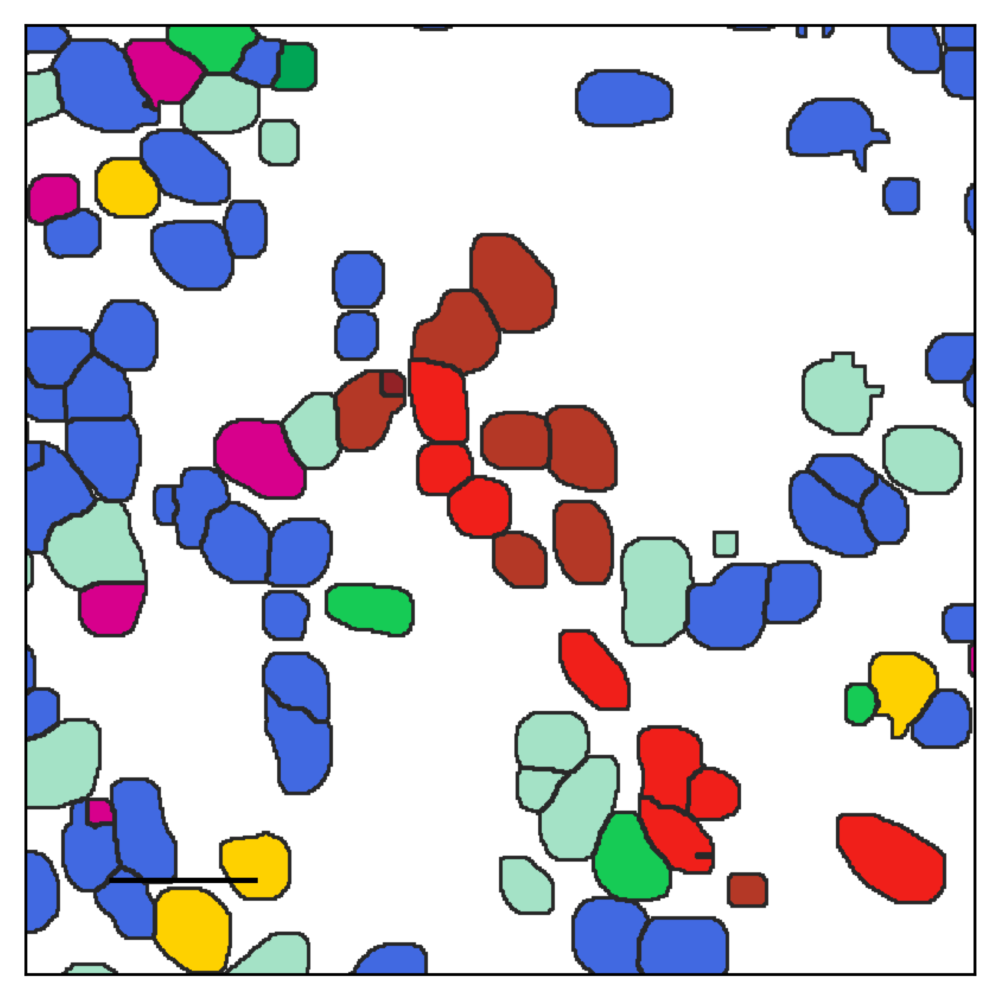

In [35]:
plt.figure(dpi=600)
plt.imshow(bountry_top)
plt.hlines(y=720,xmin=70,xmax=70+20/0.16,colors='black') # 20um
plt.xticks([])
plt.yticks([])
plt.savefig('/home/qukun/ccp1997/GBM_10X/ng_revised/figure/result_3/Figure_i_zoom_in_top.pdf',dpi=600)

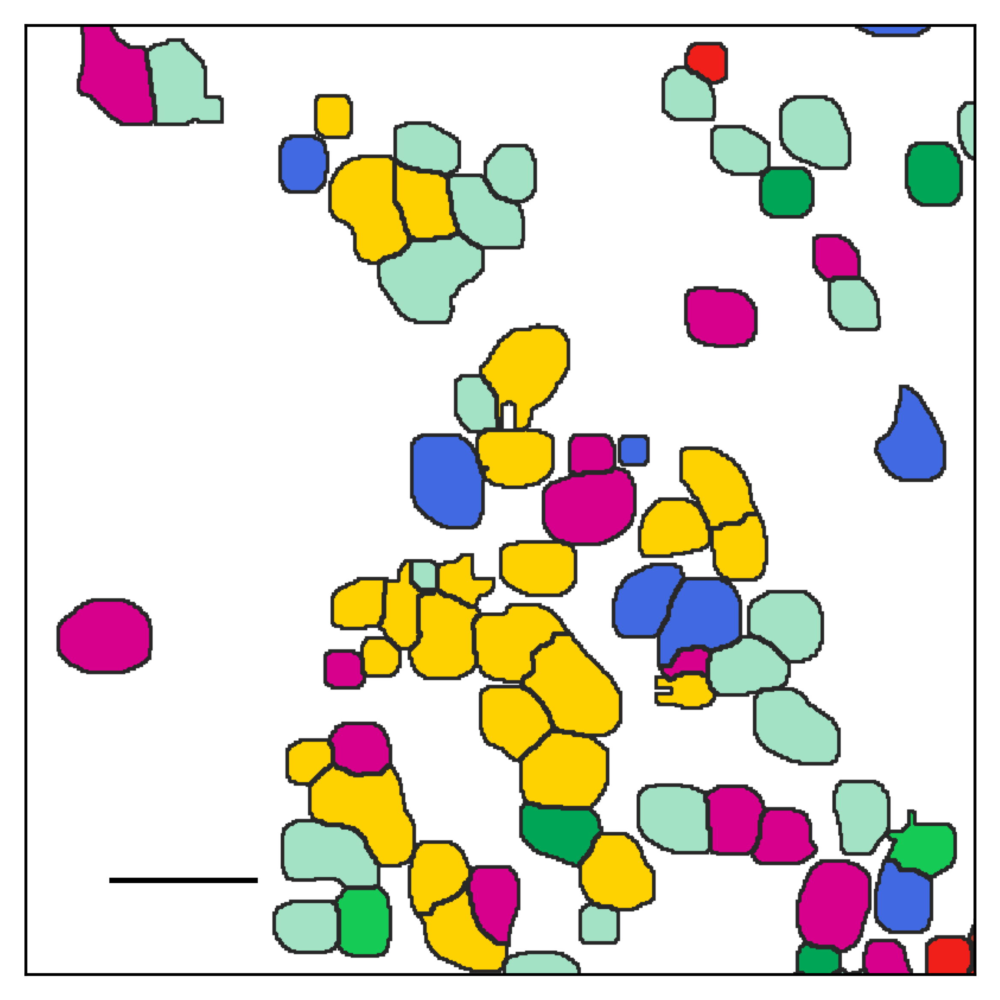

In [36]:
plt.figure(dpi=600)
plt.imshow(bountry_mid)
plt.hlines(y=720,xmin=70,xmax=70+20/0.16,colors='black') # 20um
plt.xticks([])
plt.yticks([])
plt.savefig('/home/qukun/ccp1997/GBM_10X/ng_revised/figure/result_3/Figure_i_zoom_in_mid.pdf',dpi=600)

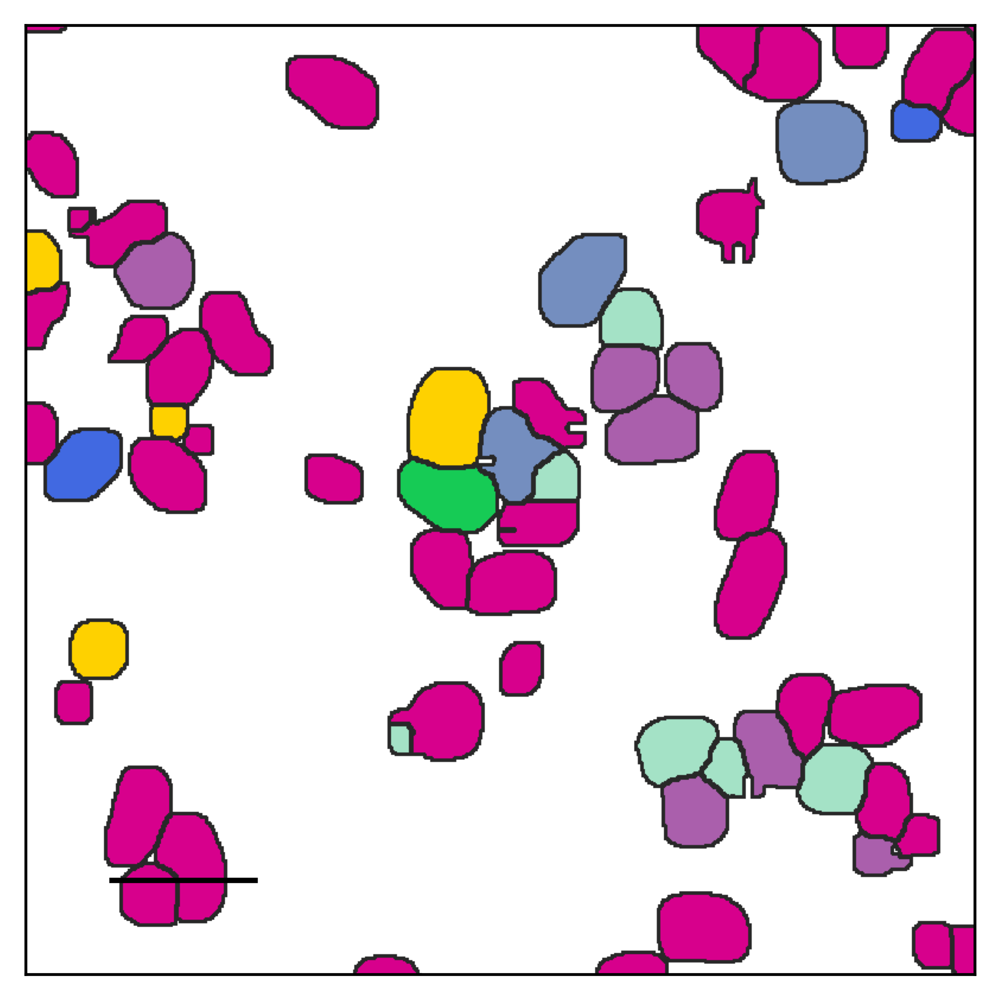

In [37]:
plt.figure(dpi=600)
plt.imshow(bountry_bot)
plt.hlines(y=720,xmin=70,xmax=70+20/0.16,colors='black') # 20um
plt.xticks([])
plt.yticks([])
plt.savefig('/home/qukun/ccp1997/GBM_10X/ng_revised/figure/result_3/Figure_i_zoom_in_bottom_v3.pdf',dpi=600)

## Grid Cellplot

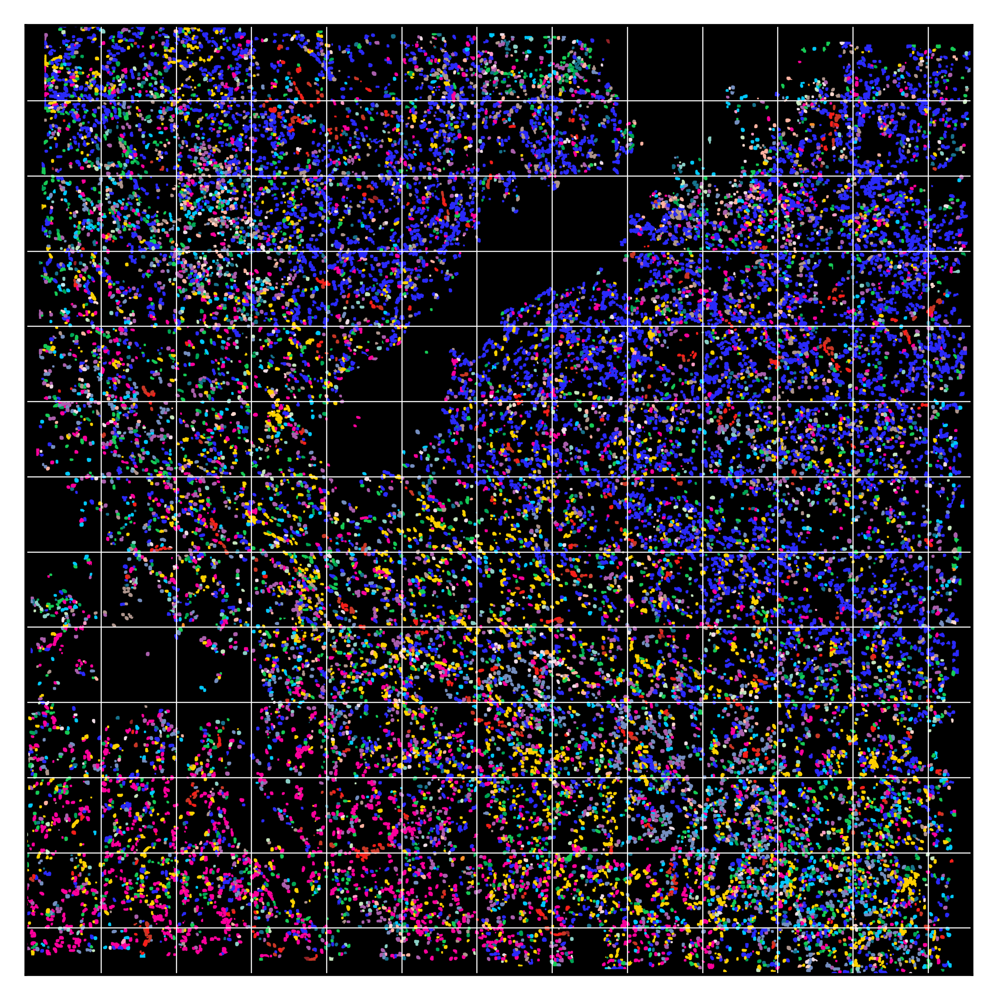

In [219]:
fig, ax = plt.subplots(1,1,dpi=600)

ax.imshow(image)
size = 1200
for i in np.arange(0, cellplot.shape[0], size)[1:]:
    ax.axhline(i, c='white', lw=0.3)
    ax.axvline(i, c='white', lw=0.3)
ax.set_xticks([])
ax.set_yticks([])
plt.savefig('/home/qukun/ccp1997/GBM_10X/ng_revised/figure/result_3/grid_cellplot.pdf',dpi=600)